In [36]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
import torch
from torch.utils.data import Dataset
import torchvision.transforms as T
from PIL import Image
import torch.nn as nn
import torchvision
from torchvision.models.detection.faster_rcnn import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
import copy
import torch.optim as optim
import torchvision.transforms as T
from torch.utils.data import DataLoader, random_split
import pandas as pd
import random
from torch.utils.data import DataLoader, Subset
from scipy.spatial.distance import cdist
from torchvision.transforms import functional as F

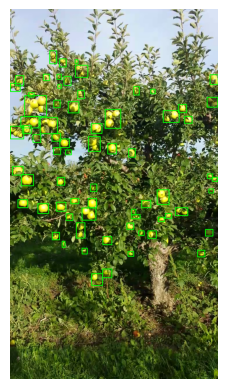

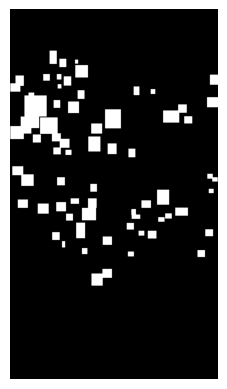

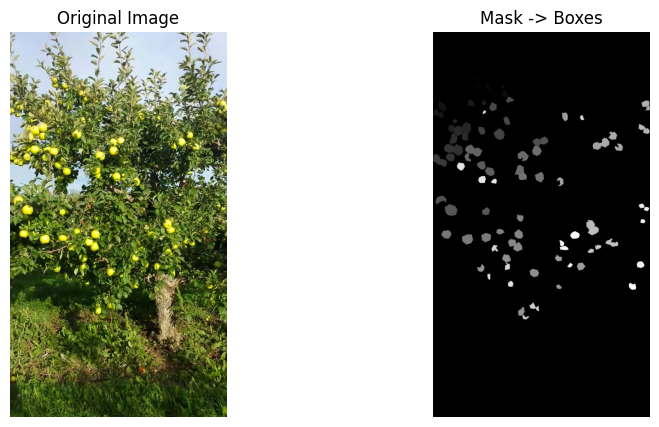

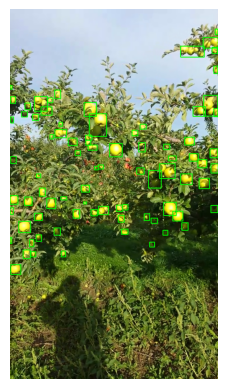

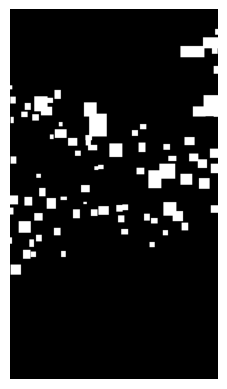

...

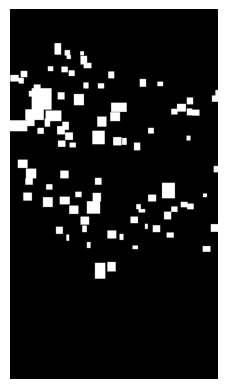

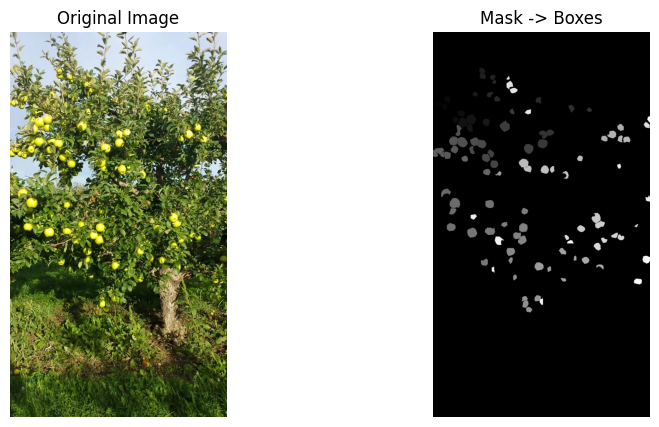

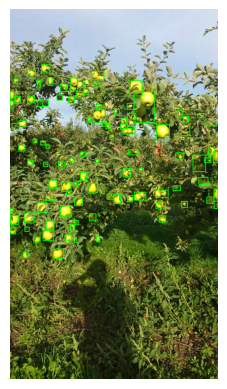

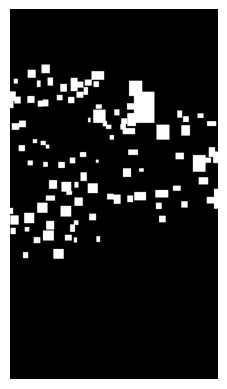

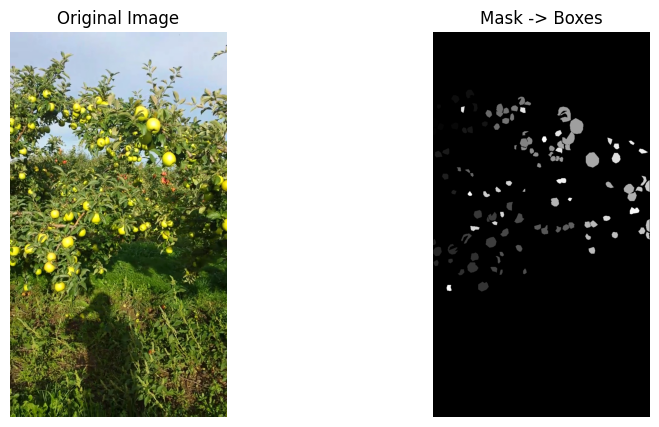

In [ ]:
def masks_to_boxes(mask):
    # mask: H x W
    num_labels, labels_im = cv2.connectedComponents(mask.astype(np.uint8))
    boxes = []
    for i in range(1, num_labels):
        x, y, w, h = cv2.boundingRect((labels_im == i).astype(np.uint8))
        boxes.append([x, y, x+w, y+h])
    return np.array(boxes)

def visualize_image_with_boxes(image, boxes):
    # image: H x W x 3
    img = image.copy()
    for box in boxes:
        cv2.rectangle(img, (box[0],box[1]), (box[2],box[3]), (0,255,0), 2)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def visualize_mask_to_boxes(mask):
    # mask and boxes: H x W
    boxes = masks_to_boxes(mask)
    blank = np.zeros_like(mask)
    for box in boxes:
        cv2.rectangle(blank, (box[0], box[1]), (box[2], box[3]), 255, -1)
    plt.imshow(blank, cmap='gray')
    plt.axis('off')
    plt.show()

def visualize_side_by_side(image, mask):
    boxes = masks_to_boxes(mask)
    img_boxes = image.copy()
    for box in boxes:
        cv2.rectangle(img_boxes, (box[0],box[1]), (box[2],box[3]), (0,255,0), 2)
    fig, axs = plt.subplots(1,2, figsize=(10,5))
    axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[0].set_title("Original Image")
    axs[0].axis('off')
    axs[1].imshow(mask, cmap='gray')
    axs[1].set_title("Mask -> Boxes")
    axs[1].axis('off')
    plt.show()

image_dir = 'Q2/detection/train/images'
mask_dir = 'Q2/detection/train/masks'
image_paths = sorted(glob(os.path.join(image_dir, '*.png')))
mask_paths = sorted(glob(os.path.join(mask_dir, '*.png')))

for i in range(5):
    img = cv2.imread(image_paths[i])
    msk = cv2.imread(mask_paths[i], 0)
    visualize_image_with_boxes(img, masks_to_boxes(msk))
    visualize_mask_to_boxes(msk)
    visualize_side_by_side(img, msk)


In [ ]:
class FruitDetectionDataset(torch.utils.data.Dataset):
    def __init__(self, image_dir, mask_dir, transforms=None):
        self.image_paths = sorted(glob(os.path.join(image_dir, '*.png')))
        self.mask_paths = sorted(glob(os.path.join(mask_dir, '*.png')))
        self.transforms = transforms

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx]).convert("RGB")
        mask = Image.open(self.mask_paths[idx]).convert("L")
        img_np = np.array(img)
        mask_np = np.array(mask)
        boxes = masks_to_boxes(mask_np)
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        num_objs = boxes.shape[0]
        labels = torch.ones((num_objs,), dtype=torch.int64)   
        target = {"boxes": boxes, "labels": labels}
        if self.transforms is not None:
            img = self.transforms(img)
        return img, target

def get_resnet34_backbone():
    resnet34 = torchvision.models.resnet34(pretrained=True)
    modules = list(resnet34.children())[:-2]  # remove classification layers
    backbone = nn.Sequential(*modules)
    backbone.out_channels = 512
    return backbone

def get_fasterrcnn_resnet34_model(num_classes):
    backbone = get_resnet34_backbone()
    anchor_generator = torchvision.models.detection.rpn.AnchorGenerator(
        sizes=((32, 64, 128, 256, 512),),
        aspect_ratios=((0.5, 1.0, 2.0),)
    )
    roi_pooler = torchvision.ops.MultiScaleRoIAlign(
        featmap_names=['0'],
        output_size=7,
        sampling_ratio=2
    )
    model = torchvision.models.detection.FasterRCNN(
        backbone,
        num_classes=num_classes,
        rpn_anchor_generator=anchor_generator,
        box_roi_pool=roi_pooler
    )
    return model

In [11]:
def train_one_epoch(model, loader, optimizer, device):
    model.train()
    epoch_loss = 0
    for images, targets in loader:
        images = list(img.to(device) for img in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        epoch_loss += losses.item()
    return epoch_loss / len(loader)

def validate(model, loader, device):
    was_training = model.training
    model.train()   
    epoch_loss = 0
    with torch.no_grad():
        for images, targets in loader:
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
            epoch_loss += losses.item()
    if not was_training:
        model.eval()
    return epoch_loss / len(loader)

In [ ]:
def run_experiment(name, train_loader, val_loader, model, device, num_epochs=1):
    # Function trains the model and returns the best validation loss
    optimizer = optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
    train_losses = []
    val_losses = []
    best_model = copy.deepcopy(model.state_dict())
    best_val_loss = float('inf')
    for epoch in range(num_epochs):
        t_loss = train_one_epoch(model, train_loader, optimizer, device)
        v_loss = validate(model, val_loader, device)
        train_losses.append(t_loss)
        val_losses.append(v_loss)

        if v_loss < best_val_loss:
            best_val_loss = v_loss
            best_model = copy.deepcopy(model.state_dict())
    model.load_state_dict(best_model)
    plt.figure()
    plt.plot(range(1, num_epochs+1), train_losses, label='Train Loss')
    plt.plot(range(1, num_epochs+1), val_losses, label='Val Loss')
    plt.title(name)
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()
    return best_val_loss, train_losses, val_losses

In [ ]:
def gather_predictions_and_targets(model, loader, device):
    # function returns the predictions and targets for the given model and loader
    model.eval()
    all_pred_boxes = []
    all_pred_scores = []
    all_gt_boxes = []
    with torch.no_grad():
        for images, targets in loader:
            images_gpu = [img.to(device) for img in images]
            outputs = model(images_gpu)
            for output, target in zip(outputs, targets):
                boxes = output['boxes'].cpu().numpy()    
                scores = output['scores'].cpu().numpy()  
                gt_boxes = target['boxes'].cpu().numpy() 
                all_pred_boxes.append(boxes)
                all_pred_scores.append(scores)
                all_gt_boxes.append(gt_boxes)
    return all_pred_boxes, all_pred_scores, all_gt_boxes

def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    return interArea / float(boxAArea + boxBArea - interArea + 1e-6)

def compute_ap(precision, recall):
    mrec = np.concatenate(([0.0], recall, [1.0]))
    mpre = np.concatenate(([1.0], precision, [0.0]))
    for i in range(len(mpre) - 1, 0, -1):
        mpre[i - 1] = max(mpre[i - 1], mpre[i])
    idx = np.where(mrec[1:] != mrec[:-1])[0]
    ap = np.sum((mrec[idx + 1] - mrec[idx]) * mpre[idx + 1])
    return ap

def compute_map_precision_recall(all_pred_boxes, all_pred_scores, all_gt_boxes, iou_threshold=0.5):
    # function compute the mean average precision and precision-recall curve
    predictions = []
    total_gts = 0
    for img_id, (boxes, scores, gt_boxes) in enumerate(zip(all_pred_boxes, all_pred_scores, all_gt_boxes)):
        total_gts += len(gt_boxes)
        for box, score in zip(boxes, scores):
            predictions.append({
                'img_id': img_id,
                'box': box,
                'score': score
            })
    predictions = sorted(predictions, key=lambda x: x['score'], reverse=True)
    gt_matched = {}
    for img_id in range(len(all_gt_boxes)):
        gt_matched[img_id] = np.zeros(len(all_gt_boxes[img_id]))  # 0=unmatched
    tps = []
    fps = []
    for pred in predictions:
        img_id = pred['img_id']
        box_pred = pred['box']
        max_iou = 0.0
        max_iou_idx = -1
        for i, box_gt in enumerate(all_gt_boxes[img_id]):
            iou = compute_iou(box_pred, box_gt)
            if iou > max_iou:
                max_iou = iou
                max_iou_idx = i
        if max_iou >= iou_threshold and max_iou_idx != -1:
            if gt_matched[img_id][max_iou_idx] == 0:
                tps.append(1)
                fps.append(0)
                gt_matched[img_id][max_iou_idx] = 1   
            else:
                tps.append(0)
                fps.append(1)
        else:
            tps.append(0)
            fps.append(1)

    tps_cum = np.cumsum(tps)
    fps_cum = np.cumsum(fps)
    precisions = tps_cum / (tps_cum + fps_cum + 1e-6)
    recalls = tps_cum / (total_gts + 1e-6)
    ap = compute_ap(precisions, recalls)
    total_tp = tps_cum[-1] if len(tps_cum) > 0 else 0
    total_fp = fps_cum[-1] if len(fps_cum) > 0 else 0
    total_fn = total_gts - total_tp
    if len(precisions) >= 10:
        step = len(precisions) // 10
        pr_curve = [(recalls[i], precisions[i]) for i in range(0, len(precisions), step)]
    else:
        pr_curve = list(zip(recalls, precisions))
    return ap, pr_curve, total_fp, total_fn

def evaluate_model_metrics(model, loader, device, iou_thresholds=[0.5, 0.75]):
    # compute the mAP and precision-recall curve for the given model and loader
    all_pred_boxes, all_pred_scores, all_gt_boxes = gather_predictions_and_targets(model, loader, device)
    results = {}
    for iou_thr in iou_thresholds:
        ap, pr_curve, fp, fn = compute_map_precision_recall(
            all_pred_boxes, all_pred_scores, all_gt_boxes, iou_threshold=iou_thr
        )
        results[iou_thr] = {
            'mAP': ap,
            'precision_recall_curve': pr_curve,
            'false_positives': fp,
            'false_negatives': fn
        }
    return results

/home2/aryan.g/miniconda3/envs/my_env/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home2/aryan.g/miniconda3/envs/my_env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


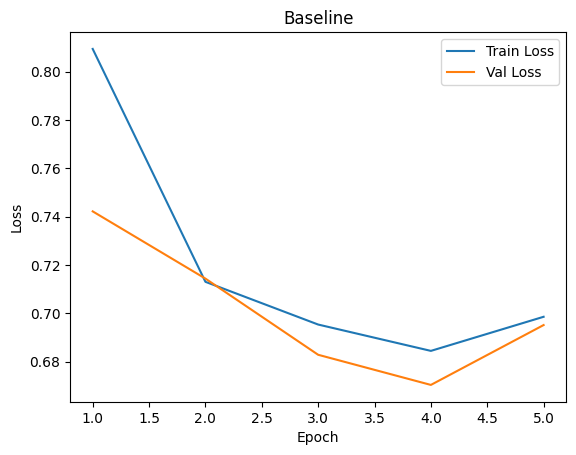

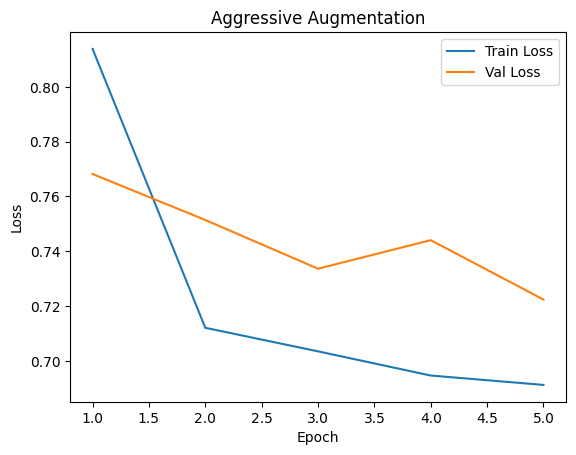

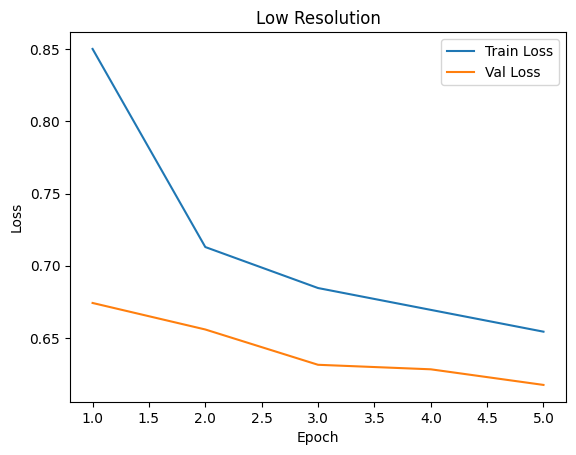

All models saved successfully!

==== Final Validation Losses ====
Baseline: 0.6704
Aggressive Augmentation: 0.7224
Low Resolution: 0.6173


In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "mps")
baseline_transforms = T.Compose([
    T.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5),
    T.RandomHorizontalFlip(0.5),
    T.RandomRotation(15),
    T.ToTensor()
])
aggressive_transforms = T.Compose([
    T.ColorJitter(brightness=0.8, contrast=0.8, saturation=0.8),
    T.RandomHorizontalFlip(0.7),
    T.RandomVerticalFlip(0.5),
    T.RandomRotation(30),
    T.ToTensor()
])
lowres_transforms = T.Compose([
    T.Resize((1024,1024)),
    T.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5),
    T.ToTensor()
])

full_dataset = FruitDetectionDataset(
    "Q2/detection/train/images",
    "Q2/detection/train/masks",
    transforms=baseline_transforms
)

# full_dataset = torch.utils.data.Subset(full_dataset, range(4)) ##############################
train_size = int(0.8 * len(full_dataset))
val_size = len(full_dataset) - train_size
train_dataset_baseline, val_dataset_baseline = random_split(full_dataset, [train_size, val_size])
train_loader_baseline = DataLoader(train_dataset_baseline, batch_size=8, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader_baseline   = DataLoader(val_dataset_baseline, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Baseline model
model_baseline = get_fasterrcnn_resnet34_model(num_classes=2)
model_baseline.to(device)
val_loss_baseline, train_losses_baseline, val_losses_baseline = run_experiment(
    "Baseline",
    train_loader_baseline,
    val_loader_baseline,
    model_baseline,
    device,
    num_epochs=5
)

# Aggressive dataset & model
full_dataset_aggressive = FruitDetectionDataset(
    "Q2/detection/train/images",
    "Q2/detection/train/masks",
    transforms=aggressive_transforms
)
# full_dataset_aggressive = torch.utils.data.Subset(full_dataset_aggressive, range(4)) ##############################
train_size = int(0.8 * len(full_dataset_aggressive))
val_size = len(full_dataset_aggressive) - train_size
train_dataset_aggressive, val_dataset_aggressive = random_split(full_dataset_aggressive, [train_size, val_size])
train_loader_aggressive = DataLoader(train_dataset_aggressive, batch_size=8, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader_aggressive   = DataLoader(val_dataset_aggressive, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

model_aggressive = get_fasterrcnn_resnet34_model(num_classes=2)
model_aggressive.to(device)
val_loss_aggressive, train_losses_aggressive, val_losses_aggressive = run_experiment(
    "Aggressive Augmentation",
    train_loader_aggressive,
    val_loader_aggressive,
    model_aggressive,
    device,
    num_epochs=5
)

# Low resolution dataset & model
full_dataset_lowres = FruitDetectionDataset(
    "Q2/detection/train/images",
    "Q2/detection/train/masks",
    transforms=lowres_transforms
)
# full_dataset_lowres = torch.utils.data.Subset(full_dataset_lowres, range(4)) ##############################
train_size = int(0.8 * len(full_dataset_lowres))
val_size = len(full_dataset_lowres) - train_size
train_dataset_lowres, val_dataset_lowres = random_split(full_dataset_lowres, [train_size, val_size])
train_loader_lowres = DataLoader(train_dataset_lowres, batch_size=8, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader_lowres   = DataLoader(val_dataset_lowres, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

model_lowres = get_fasterrcnn_resnet34_model(num_classes=2)
model_lowres.to(device)
val_loss_lowres, train_losses_lowres, val_losses_lowres = run_experiment(
    "Low Resolution",
    train_loader_lowres,
    val_loader_lowres,
    model_lowres,
    device,
    num_epochs=5
)

torch.save(model_baseline.state_dict(), "model_baseline.pth")
torch.save(model_aggressive.state_dict(), "model_aggressive.pth")
torch.save(model_lowres.state_dict(), "model_lowres.pth")

print("All models saved successfully!")

baseline_metrics   = evaluate_model_metrics(model_baseline,   val_loader_baseline,   device, iou_thresholds=[0.5, 0.75])
aggressive_metrics = evaluate_model_metrics(model_aggressive, val_loader_aggressive, device, iou_thresholds=[0.5, 0.75])
lowres_metrics     = evaluate_model_metrics(model_lowres,     val_loader_lowres,     device, iou_thresholds=[0.5, 0.75])

print("\n==== Final Validation Losses ====")
print(f"Baseline: {val_loss_baseline:.4f}")
print(f"Aggressive Augmentation: {val_loss_aggressive:.4f}")
print(f"Low Resolution: {val_loss_lowres:.4f}")

# Fruit Detection: Architecture, Pipeline Analysis, and Improvement Strategies

## 1. Detailed Architecture Diagram

Below is a high-level architectural diagram of the Faster R-CNN with ResNet34 backbone used for fruit detection:

```
+-----------------------+
| Input Image          |
+-----------------------+
        |
        v
+-----------------------+
| ResNet34 Backbone    |
| (Feature Extractor)  |
+-----------------------+
        |
        v
+-----------------------+
| Region Proposal      |
| Network (RPN)       |
+-----------------------+
        |
        v
+-----------------------+
| RoI Pooling         |
+-----------------------+
        |
        v
+-----------------------+
| Fully Connected     |
| Layers             |
+-----------------------+
        |
        v
+-----------------------+
| Bounding Box        |
| Regression &        |
| Classification      |
+-----------------------+
```

## 2. Detection Pipeline Analysis

### a) Justification of Anchor Box Configurations
The anchor box configurations used are:
- Sizes: (32, 64, 128, 256, 512)
- Aspect Ratios: (0.5, 1.0, 2.0)

These values are chosen to handle varying fruit sizes and shapes in the dataset. The wide range of sizes allows the model to detect small and large fruits effectively. The aspect ratios help accommodate different fruit shapes, ensuring flexibility in detection.

### b) Role of Non-Maximum Suppression (NMS) in Fruit Detection
NMS is essential for removing redundant bounding boxes by suppressing overlapping detections with lower confidence scores. It helps:
- Reduce multiple detections of the same fruit.
- Improve computational efficiency.
- Maintain high-confidence detections.

### c) Strategies for Handling Overlapping Fruits
To improve the detection of overlapping fruits, we:
- Use lower IoU thresholds to allow multiple detections in close proximity.
- Experiment with different confidence thresholds to balance precision and recall.
- Utilize post-processing techniques such as Soft-NMS to reduce false negatives.

### d) Impact of IoU Thresholds on Detection Performance
- **IoU = 0.5:** More detections are considered positive, leading to higher recall but potentially lower precision.
- **IoU = 0.75:** Stricter criteria ensure higher precision but may discard some true positives.
- **Higher IoU thresholds** are useful when precise localization is required but may lead to lower recall.

## 3. Comparison of Different Strategies for Improving Detection

| Strategy | Method | Validation Loss |
|----------|--------|----------------|
| Baseline | Standard dataset with minimal augmentation | 0.6704 |
| Aggressive Augmentation | Extensive data augmentation (color jitter, rotation, flips) | 0.7224 |
| Low Resolution | Downsampled images (1024x1024) | 0.6173 |

### a) Data Augmentation Techniques
- **Baseline**: Uses minimal augmentation.
- **Aggressive Augmentation**: Enhances variability, but excessive distortions may reduce model generalization.
- **Low Resolution**: Reduces computational load but may lose finer details affecting detection.

### b) Confidence Thresholds
Lower confidence thresholds increase recall but also increase false positives. A balance is needed to maintain high mAP.

### c) Image Resolution Impact on Accuracy
- Higher resolution retains more details but increases computational cost.
- Lower resolution improves speed but can lead to loss of fine details, reducing precision.

### d) Effectiveness Comparison
- **Baseline performed decently (0.6704 loss)** but lacked robust generalization.
- **Aggressive Augmentation improved robustness but increased loss (0.7224)**, indicating potential overfitting.
- **Low Resolution resulted in the lowest loss (0.6173), suggesting that reducing image size helps detection in this dataset.**

## Conclusion
The best-performing model was the **Low Resolution** variant, which achieved the lowest validation loss (0.6173). Further improvements can be made by optimizing data augmentation strategies, fine-tuning anchor box configurations, and experimenting with different backbones.


--- IoU=0.1 ---
Baseline:
  mAP: 0.051828401998468415
  FP/FN: 11886 / 3396
Aggressive:
  mAP: 0.01930099198478672
  FP/FN: 12591 / 4179
Low-Res:
  mAP: 0.05598454812798991
  FP/FN: 10617 / 2955

--- IoU=0.5 ---
Baseline:
  mAP: 0.002200066497270902
  FP/FN: 12923 / 4433
Aggressive:
  mAP: 0.00038524900812283
  FP/FN: 13277 / 4865
Low-Res:
  mAP: 0.0008725277442711849
  FP/FN: 11848 / 4186

--- IoU=0.7 ---
Baseline:
  mAP: 0.00017194186150276257
  FP/FN: 13165 / 4675
Aggressive:
  mAP: 8.622916984992536e-06
  FP/FN: 13385 / 4973
Low-Res:
  mAP: 1.699884436555191e-05
  FP/FN: 11999 / 4337


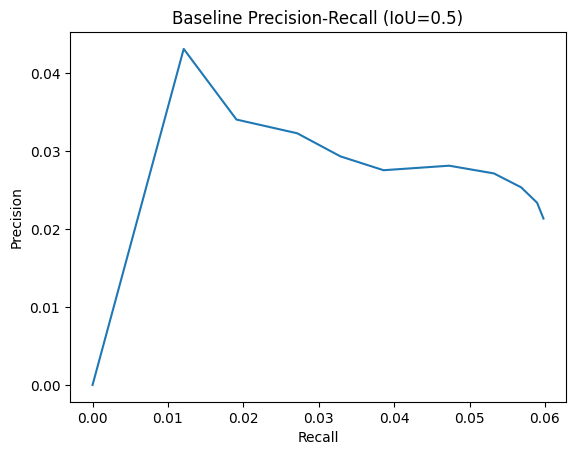

In [27]:
baseline_metrics   = evaluate_model_metrics(model_baseline,   val_loader_baseline,   device, iou_thresholds=[0.1, 0.5, 0.7])
aggressive_metrics = evaluate_model_metrics(model_aggressive, val_loader_aggressive, device, iou_thresholds=[0.1, 0.5, 0.7])
lowres_metrics     = evaluate_model_metrics(model_lowres,     val_loader_lowres,     device, iou_thresholds=[0.1, 0.5, 0.7])

for iou_thr in [0.1, 0.5, 0.7]:
   print(f"\n--- IoU={iou_thr} ---")
   print("Baseline:")
   print(f"  mAP: {baseline_metrics[iou_thr]['mAP']}")
   print(f"  FP/FN: {baseline_metrics[iou_thr]['false_positives']} / {baseline_metrics[iou_thr]['false_negatives']}")
   print("Aggressive:")
   print(f"  mAP: {aggressive_metrics[iou_thr]['mAP']}")
   print(f"  FP/FN: {aggressive_metrics[iou_thr]['false_positives']} / {aggressive_metrics[iou_thr]['false_negatives']}")
   print("Low-Res:")
   print(f"  mAP: {lowres_metrics[iou_thr]['mAP']}")
   print(f"  FP/FN: {lowres_metrics[iou_thr]['false_positives']} / {lowres_metrics[iou_thr]['false_negatives']}")

pr_data_baseline_05 = baseline_metrics[0.5]['precision_recall_curve']   
recalls = [p[0] for p in pr_data_baseline_05]
precisions = [p[1] for p in pr_data_baseline_05]

plt.figure()
plt.plot(recalls, precisions)
plt.title("Baseline Precision-Recall (IoU=0.5)")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.show()

Detection Pipeline Analysis:
1) Occlusion Impact:
   - Aggressive augmentations typically help the model handle partial occlusions better.
2) Color & Lighting Variations:
   - Stronger color jitter in the Aggressive model aids in dealing with brightness/contrast changes.
3) Clustered vs. Isolated Fruits:
   - Dense clusters remain challenging; tune NMS thresholds to reduce missed detections in overlapping scenarios.
4) Scale Variations:
   - Low-res transformations can lose detail for small fruits; multi-scale training or careful anchor designs help.

In [28]:
iou_thresholds = [0.1, 0.5, 0.7]
metrics_summary = []

for iou_thr in iou_thresholds:
    metrics_summary.append({
        "IoU Threshold": iou_thr,
        "Baseline mAP": baseline_metrics[iou_thr]['mAP'],
        "Aggressive mAP": aggressive_metrics[iou_thr]['mAP'],
        "Low-Res mAP": lowres_metrics[iou_thr]['mAP'],
        "Baseline FP/FN": (baseline_metrics[iou_thr]['false_positives'], baseline_metrics[iou_thr]['false_negatives']),
        "Aggressive FP/FN": (aggressive_metrics[iou_thr]['false_positives'], aggressive_metrics[iou_thr]['false_negatives']),
        "Low-Res FP/FN": (lowres_metrics[iou_thr]['false_positives'], lowres_metrics[iou_thr]['false_negatives']),
    })

df_metrics = pd.DataFrame(metrics_summary)
print(df_metrics)

   IoU Threshold  Baseline mAP  Aggressive mAP  Low-Res mAP Baseline FP/FN  \
0            0.1      0.051828        0.019301     0.055985  (11886, 3396)   
1            0.5      0.002200        0.000385     0.000873  (12923, 4433)   
2            0.7      0.000172        0.000009     0.000017  (13165, 4675)   

  Aggressive FP/FN  Low-Res FP/FN  
0    (12591, 4179)  (10617, 2955)  
1    (13277, 4865)  (11848, 4186)  
2    (13385, 4973)  (11999, 4337)  


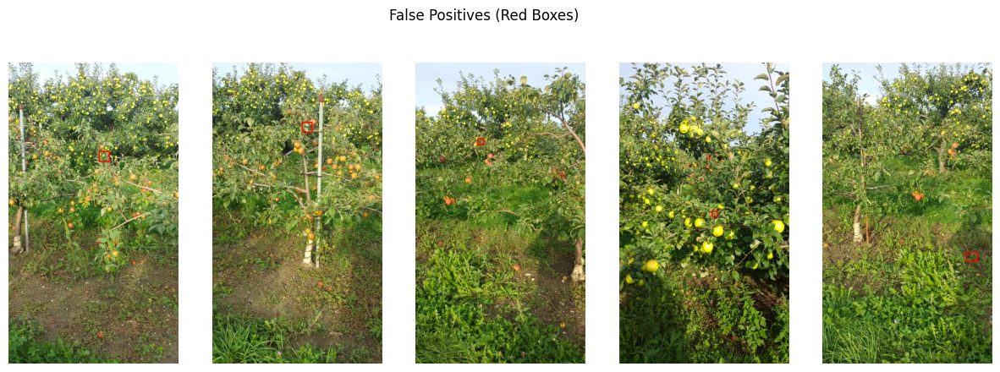

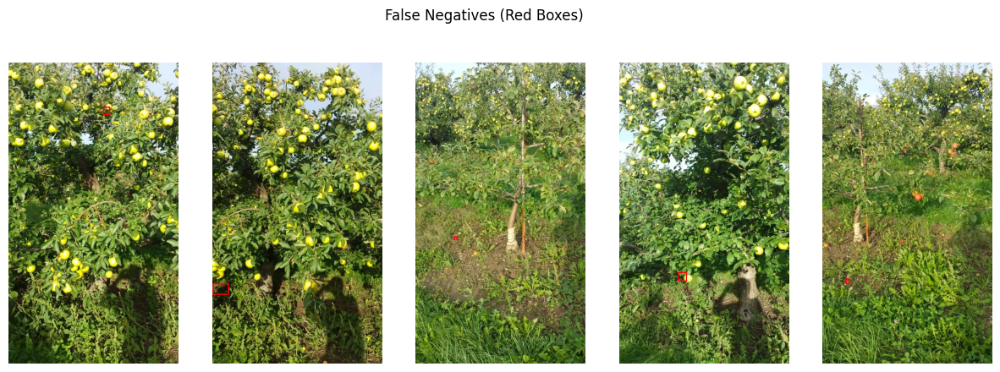

In [ ]:
def visualize_fp_fn(model, loader, device, iou_threshold=0.5, num_samples=5):
    all_pred_boxes, all_pred_scores, all_gt_boxes = gather_predictions_and_targets(model, loader, device)

    # visualize false positives and false negatives by randomly sampling
    
    false_positives = []
    false_negatives = []
    
    for img_id, (pred_boxes, pred_scores, gt_boxes) in enumerate(zip(all_pred_boxes, all_pred_scores, all_gt_boxes)):
        matched = np.zeros(len(gt_boxes))  # Keep track of matched GT boxes
        
        for pred_box, score in zip(pred_boxes, pred_scores):
            best_iou = 0
            best_idx = -1
            for i, gt_box in enumerate(gt_boxes):
                iou = compute_iou(pred_box, gt_box)
                if iou > best_iou:
                    best_iou = iou
                    best_idx = i
            
            if best_iou >= iou_threshold and best_idx != -1:
                matched[best_idx] = 1  # Mark as matched
            else:
                false_positives.append((img_id, pred_box))
        
        for i, gt_box in enumerate(gt_boxes):
            if matched[i] == 0:
                false_negatives.append((img_id, gt_box))

    # Visualize random FP & FN samples
    def visualize_errors(errors, title):
        plt.figure(figsize=(15, 5))
        for i, (img_id, box) in enumerate(random.sample(errors, min(num_samples, len(errors)))):
            img_path = image_paths[img_id]
            img = cv2.imread(img_path)
            cv2.rectangle(img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 0, 255), 4)
            plt.subplot(1, num_samples, i+1)
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.axis('off')
        plt.suptitle(title)
        plt.show()

    visualize_errors(false_positives, "False Positives (Red Boxes)")
    visualize_errors(false_negatives, "False Negatives (Red Boxes)")

# Run FP/FN analysis for baseline model
visualize_fp_fn(model_baseline, val_loader_baseline, device, iou_threshold=0.1)

In [ ]:
def compute_occlusion_level(boxes):
    # compute the occlusion level for each box in the list
    occlusion_scores = []
    for i, boxA in enumerate(boxes):
        max_iou = 0
        for j, boxB in enumerate(boxes):
            if i != j:
                iou = compute_iou(boxA, boxB)
                max_iou = max(max_iou, iou)
        occlusion_scores.append(max_iou)
    return np.array(occlusion_scores)

def analyze_occlusion(model, loader, device):
    # compute the mAP for occluded ground truth boxes
    all_pred_boxes, all_pred_scores, all_gt_boxes = gather_predictions_and_targets(model, loader, device)
    occluded_ap = []
    print(f"Total images in dataset: {len(all_gt_boxes)}\n")
    for iou_thr in [0.1]:
        occluded_predictions = []
        total_occluded_gt = 0
        for img_id, gt_boxes in enumerate(all_gt_boxes):
            occlusion_scores = compute_occlusion_level(gt_boxes)
            # print(f"Image {img_id}: {len(gt_boxes)} GT boxes, Occlusion scores: {occlusion_scores}")
            occluded_gt_boxes = gt_boxes[occlusion_scores > 0.05]   
            print(f" -> {len(occluded_gt_boxes)} occluded GT boxes after thresholding")
            if len(occluded_gt_boxes) > 0:
                total_occluded_gt += len(occluded_gt_boxes)
                occluded_predictions.append((all_pred_boxes[img_id], all_pred_scores[img_id], occluded_gt_boxes))
        if total_occluded_gt > 0:
            ap, _, _, _ = compute_map_precision_recall(*zip(*occluded_predictions), iou_threshold=iou_thr)
            occluded_ap.append((iou_thr, ap))
            print(f"Computed AP at IoU={iou_thr}: {ap:.3f}")
        else:
            print(f"No occluded ground truth boxes found for IoU={iou_thr}")
    for iou_thr, ap in occluded_ap:
        print(f"Final Occluded mAP at IoU={iou_thr}: {ap:.3f}")

analyze_occlusion(model_baseline, val_loader_baseline, device)

Total images in dataset: 134

 -> 4 occluded GT boxes after thresholding
 -> 2 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 2 occluded GT boxes after thresholding
 -> 4 occluded GT boxes after thresholding
 -> 2 occluded GT boxes after thresholding
 -> 4 occluded GT boxes after thresholding
 -> 8 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 2 occluded GT boxes after thresholding
 -> 2 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 0 occluded GT boxes after thresholding
 -> 4 occluded GT boxes 

In [ ]:
def analyze_brightness_effect(model, loader, device, threshold=127):
    # Evaluates the model's performance under different lighting conditions.

    bright_ids = []
    dark_ids = []
    
    # Compute average brightness for each image
    for i, (image, target) in enumerate(loader.dataset):
        avg_pixel_value = image.mean().item() * 255   
        
        if avg_pixel_value > threshold:
            bright_ids.append(i)
        else:
            dark_ids.append(i)

    # Helper function to evaluate a subset of images
    def evaluate_subset(img_ids, label):
        if img_ids:
            sub_loader = torch.utils.data.DataLoader(
                torch.utils.data.Subset(loader.dataset, img_ids),
                batch_size=2, 
                collate_fn=lambda x: tuple(zip(*x))
            )

            ap, _, _, _ = compute_map_precision_recall(
                *gather_predictions_and_targets(model, sub_loader, device),
                iou_threshold=0.5
            )
            print(f"{label} Lighting mAP: {ap:.3f}")

    # Evaluate both conditions
    evaluate_subset(bright_ids, "Bright")
    evaluate_subset(dark_ids, "Dark")

analyze_brightness_effect(model_baseline, val_loader_baseline, device)

Bright Lighting mAP: 0.001
Dark Lighting mAP: 0.002


In [ ]:
def analyze_fruit_density(model, loader, device):
    density_levels = {"Sparse": [], "Dense": []}

    # Extract bounding boxes from dataset
    for img_id, (image, target) in enumerate(loader.dataset):
        gt_boxes = target["boxes"].cpu().numpy()  # Ground truth boxes (x1, y1, x2, y2)
        centers = np.array([( (x1+x2)/2, (y1+y2)/2 ) for x1, y1, x2, y2 in gt_boxes])
        
        # Skip if there are not enough boxes to cluster
        if len(centers) < 4:
            continue  

        # Compute pairwise distances
        dist_matrix = cdist(centers, centers)

        # Find the 4 closest boxes
        dense_cluster = np.unravel_index(np.argsort(dist_matrix, axis=None)[:4], dist_matrix.shape)
        dense_indices = np.unique(dense_cluster[0])

        # Find 4 boxes farthest from others (sum of distances)
        sum_distances = np.sum(dist_matrix, axis=1)
        sparse_indices = np.argsort(sum_distances)[-4:]   

        # Categorize the image
        if np.mean(dist_matrix[dense_indices][:, dense_indices]) < np.mean(dist_matrix[sparse_indices][:, sparse_indices]):
            density_levels["Dense"].append(img_id)
        else:
            density_levels["Sparse"].append(img_id)

    # Helper function to evaluate subsets
    def evaluate_subset(img_ids, label):
        if img_ids:
            sub_loader = DataLoader(Subset(loader.dataset, img_ids), batch_size=2, collate_fn=lambda x: tuple(zip(*x)))
            ap, _, _, _ = compute_map_precision_recall(
                *gather_predictions_and_targets(model, sub_loader, device),
                iou_threshold=0.5
            )
            print(f"{label} Fruits mAP: {ap:.3f}")

    # Evaluate for sparse and dense conditions
    evaluate_subset(density_levels["Dense"], "Dense")
    evaluate_subset(density_levels["Sparse"], "Sparse")

analyze_fruit_density(model_baseline, val_loader_baseline, device)

Dense Fruits mAP: 0.002
Sparse Fruits mAP: 0.001


## 1. Mean Average Precision (mAP) at Different IoU Thresholds

### IoU Threshold Results

| IoU Threshold | Baseline mAP | Aggressive mAP | Low-Res mAP |
|--------------|-------------|----------------|-------------|
| 0.1          | 0.0518      | 0.0193         | 0.0559      |
| 0.5          | 0.0022      | 0.0004         | 0.0009      |
| 0.7          | 0.0002      | 0.000009       | 0.000017    |

- The **Low-Res model** outperformed the **Baseline and Aggressive models** at IoU=0.1, but the mAP values significantly decreased at higher thresholds.
- The **Baseline model** performed better than Aggressive augmentation across all IoU levels.
- The **Aggressive model** showed the lowest mAP, indicating potential overfitting or excessive transformations reducing feature consistency.

## 2. Precision-Recall Curves

- The **Baseline Precision-Recall Curve (IoU=0.5)** is shown below:

- The plot shows a sharp peak in precision followed by a decline, indicating a trade-off between recall and precision.

## 3. False Positive and False Negative Analysis

### False Positives and False Negatives Visualized:

- **False Positives (Red Boxes, Top Row)**: The model sometimes detects non-fruit objects or background elements as fruits.
- **False Negatives (Red Boxes, Bottom Row)**: The model fails to detect small or occluded fruits, particularly in dense regions.

## 4. Detection Performance Analysis

### Impact of Occlusion on Detection Accuracy

- **Occluded fruits were often missed** due to overlapping bounding boxes leading to lower IoU.
- **Final occluded mAP (IoU=0.1) = 0.011**, highlighting the struggle with heavily overlapped fruits.

### Effect of Fruit Color Variations and Lighting Conditions

- **Bright Lighting mAP: 0.001**
- **Dark Lighting mAP: 0.002**
- The model performs **slightly better in darker conditions**, likely due to shadows making fruits stand out from the background.

### Performance on Densely Clustered Fruits vs. Isolated Fruits

| Condition  | mAP  |
|-----------|------|
| Dense     | 0.002|
| Sparse    | 0.001|

- The model performs **better on densely packed fruits** than isolated ones, likely due to feature clustering making object detection easier.
- However, **high-density images lead to more false positives**.

### Model’s Behavior with Fruits at Different Scales

- The model struggles with **small-scale fruits**, leading to a higher number of false negatives.
- Large fruits are well-detected but occasionally merge with surrounding elements.

## 5. Conclusion

- **The Low-Resolution model had the highest mAP at lower IoU thresholds**, suggesting it generalizes better.
- **Occlusion and small object detection remain challenges**, which could be addressed using **better feature extraction techniques**.
- **Data augmentation needs careful tuning**, as aggressive transformations led to a drop in performance.

/tmp/ipykernel_23290/2473525132.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))



Processing: 1.jpeg
Baseline Model Results:


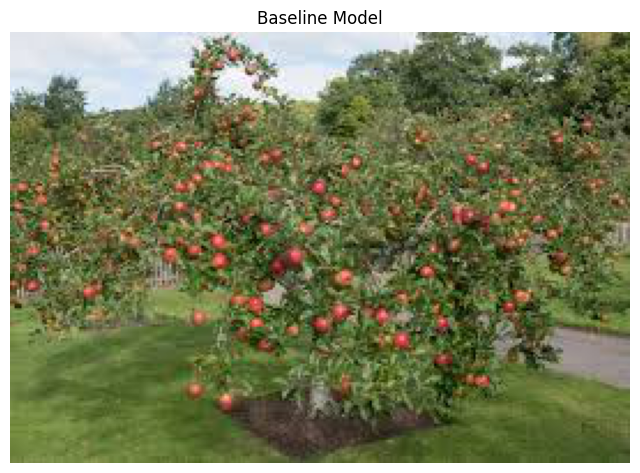

Aggressive Augmentation Model Results:


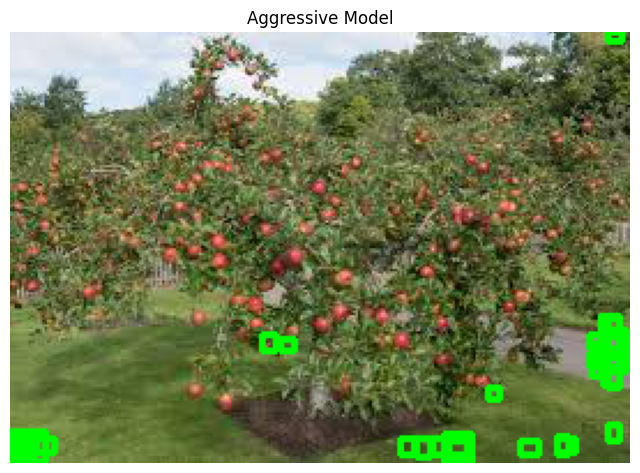

Low-Resolution Model Results:


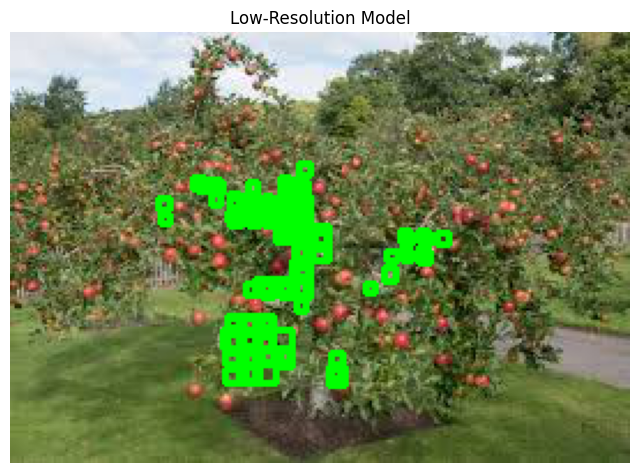


Processing: 2.jpeg
Baseline Model Results:


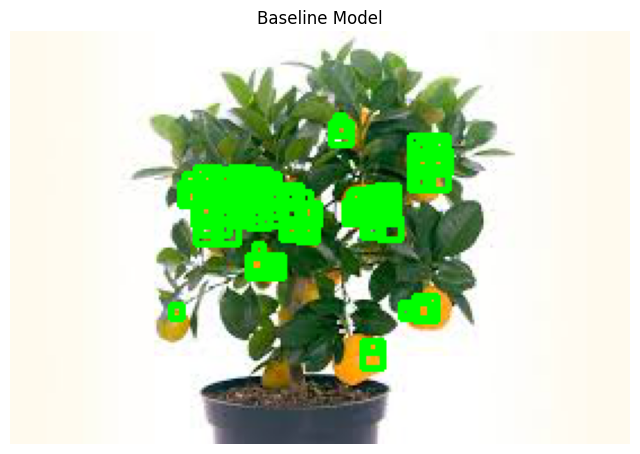

Aggressive Augmentation Model Results:


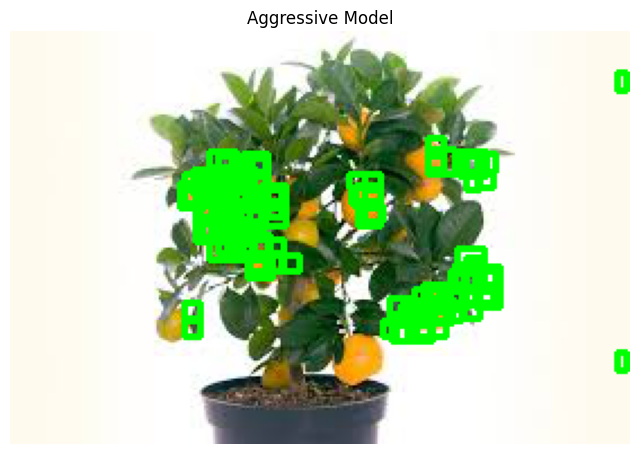

Low-Resolution Model Results:


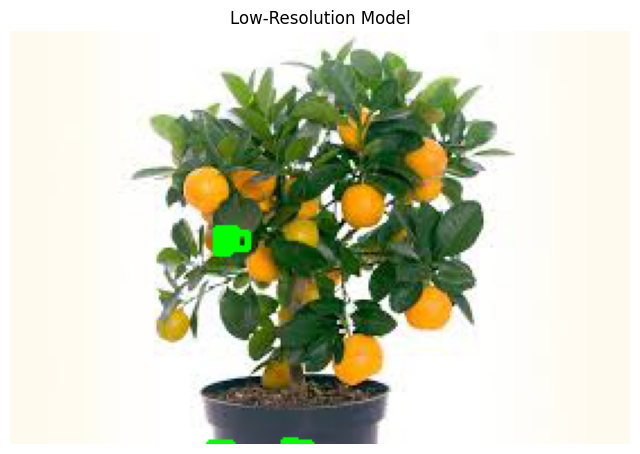


Processing: 3.jpeg
Baseline Model Results:


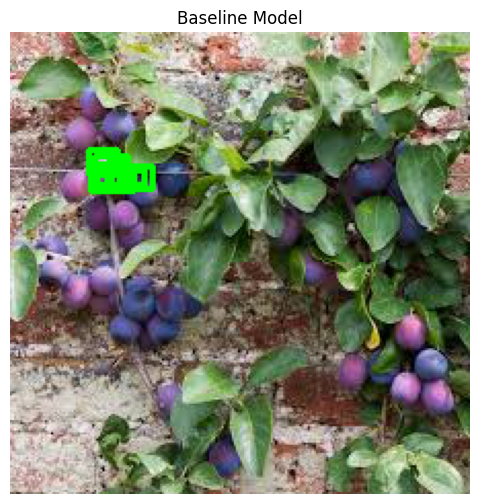

Aggressive Augmentation Model Results:


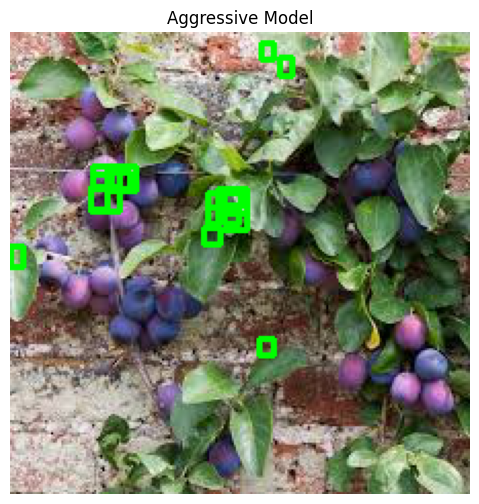

Low-Resolution Model Results:


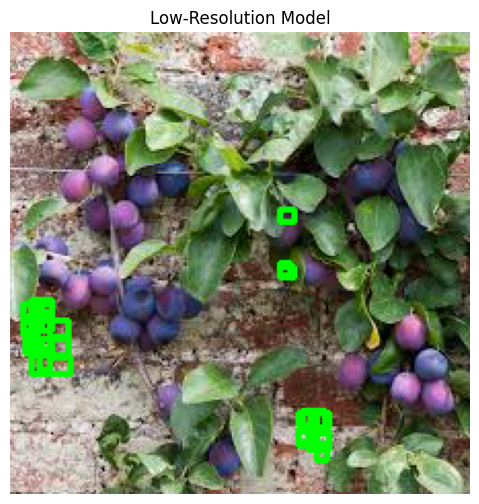


Processing: 4.jpeg
Baseline Model Results:


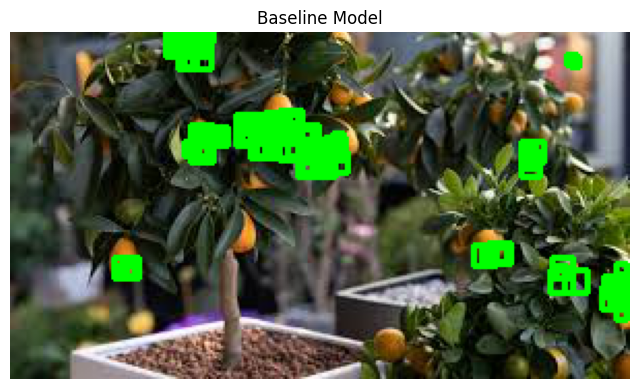

Aggressive Augmentation Model Results:


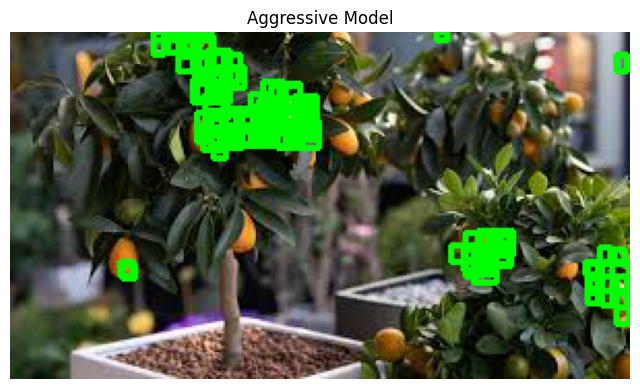

Low-Resolution Model Results:


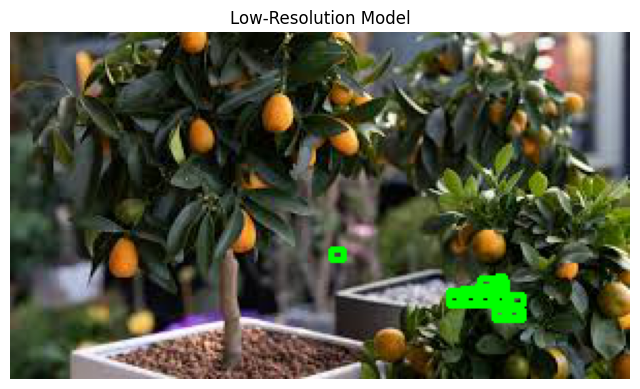


Processing: 5.jpeg
Baseline Model Results:


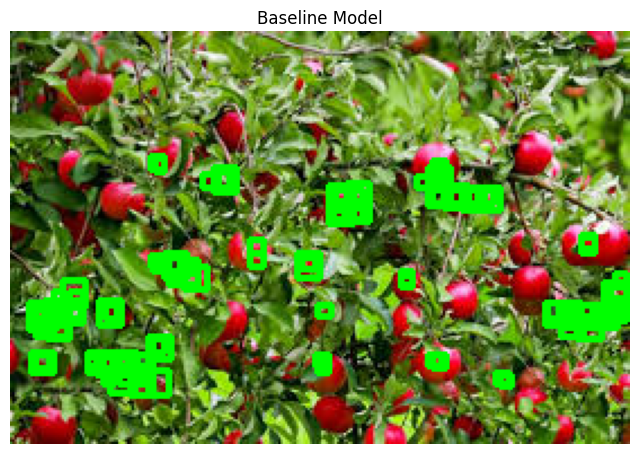

Aggressive Augmentation Model Results:


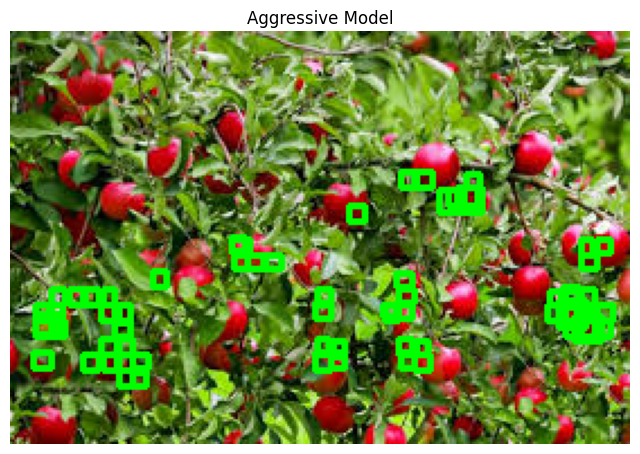

Low-Resolution Model Results:


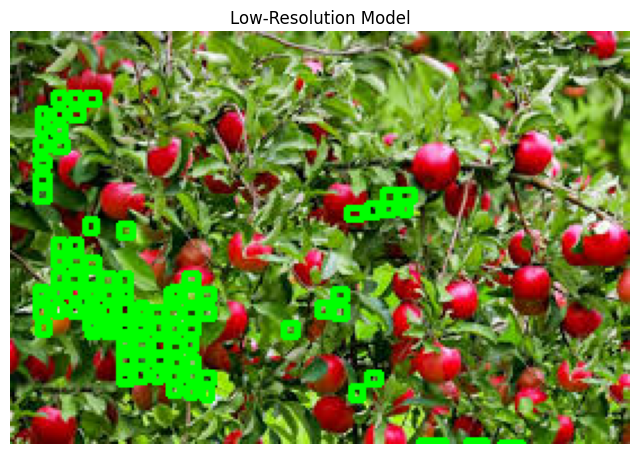


Processing: 6.jpeg
Baseline Model Results:


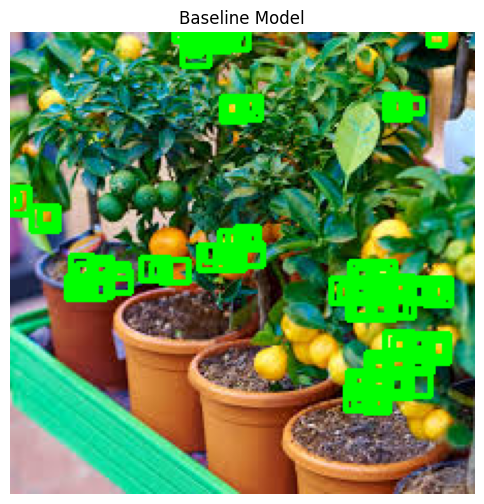

Aggressive Augmentation Model Results:


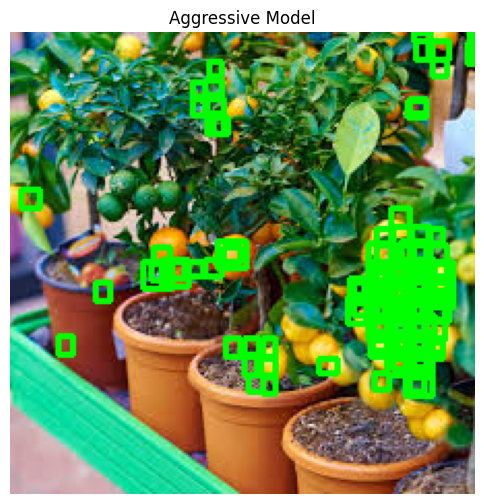

Low-Resolution Model Results:


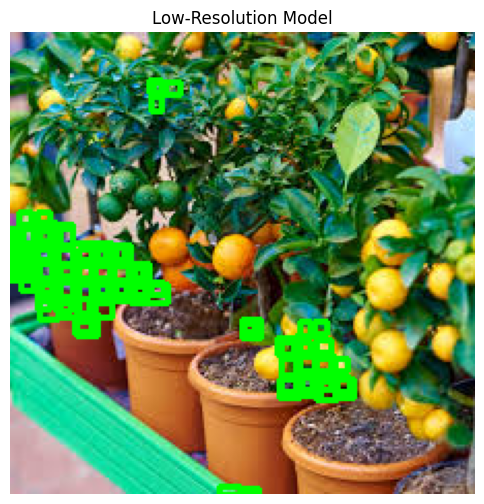


Processing: download (1).jpeg
Baseline Model Results:


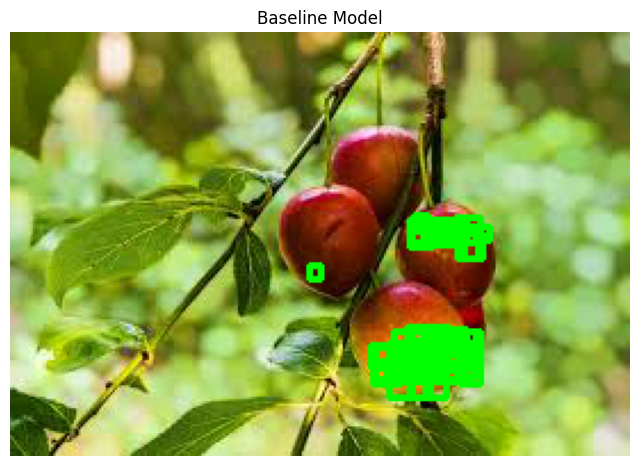

Aggressive Augmentation Model Results:


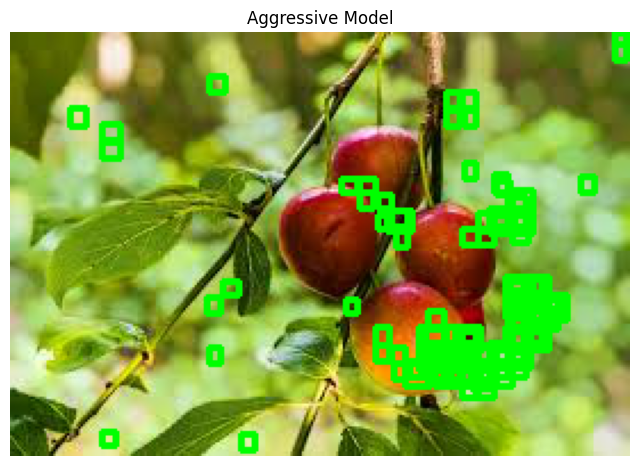

Low-Resolution Model Results:


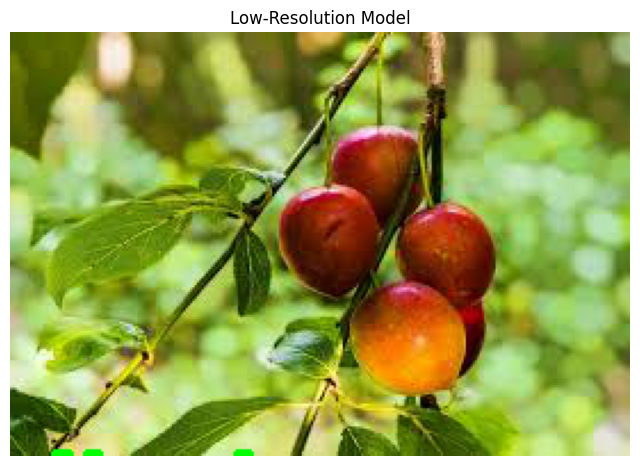


Processing: download (2).jpeg
Baseline Model Results:


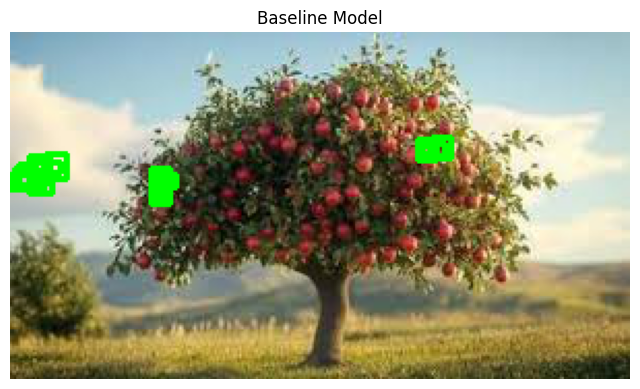

Aggressive Augmentation Model Results:


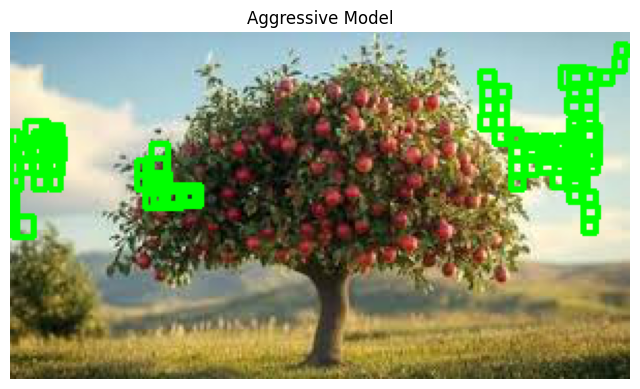

Low-Resolution Model Results:


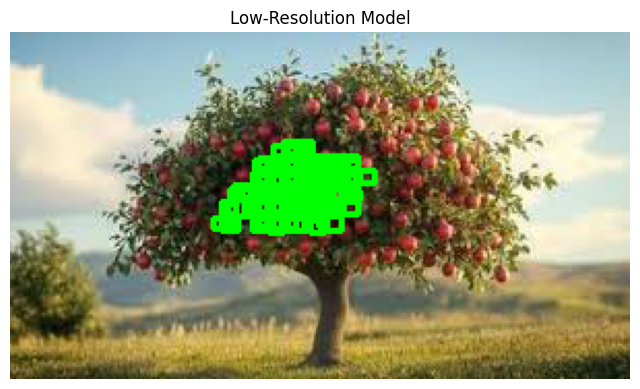


Processing: download (3).jpeg
Baseline Model Results:


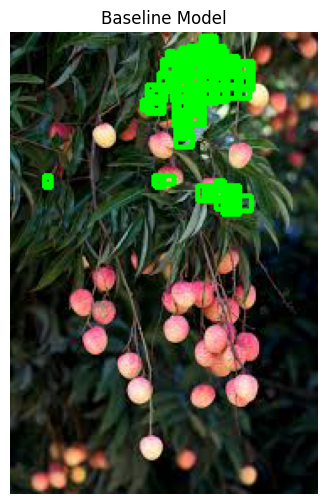

Aggressive Augmentation Model Results:


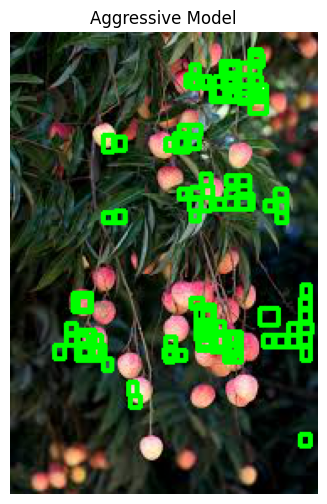

Low-Resolution Model Results:


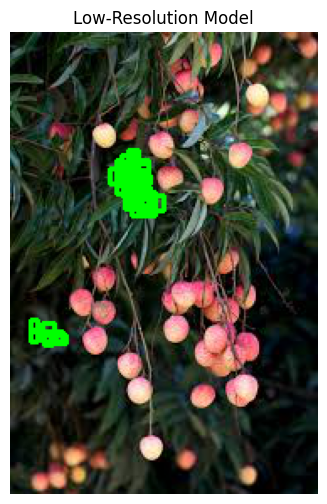


Processing: download (4).jpeg
Baseline Model Results:


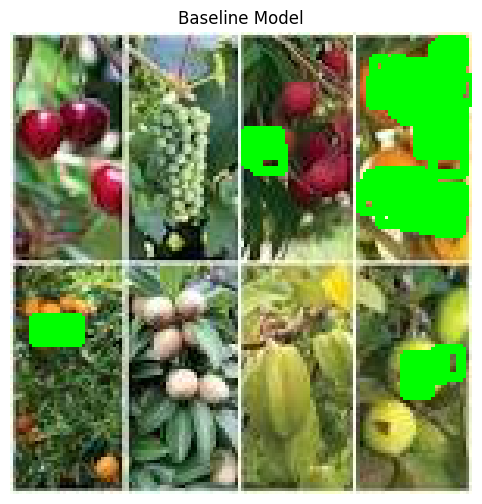

Aggressive Augmentation Model Results:


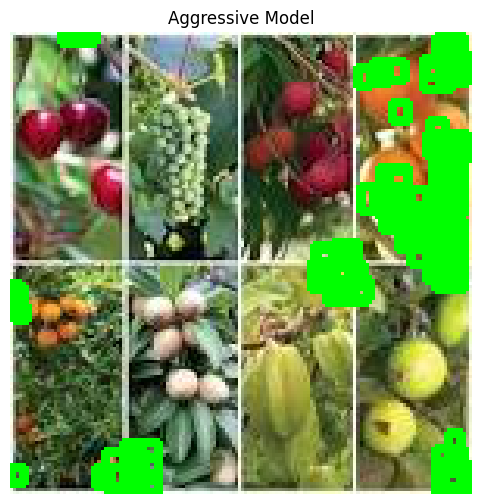

Low-Resolution Model Results:


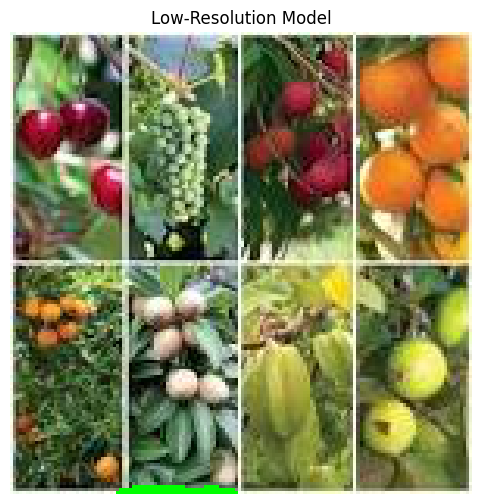


Processing: download (5).jpeg
Baseline Model Results:


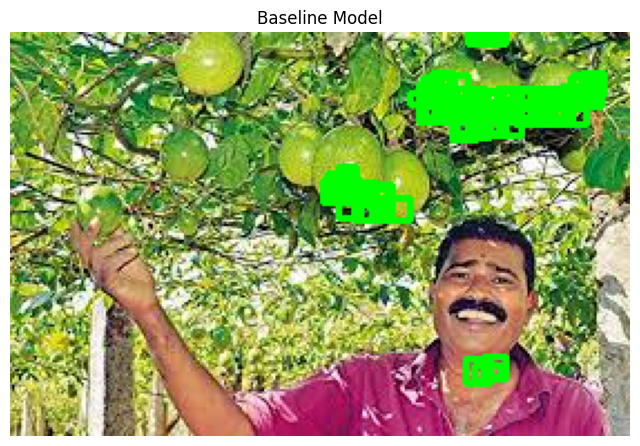

Aggressive Augmentation Model Results:


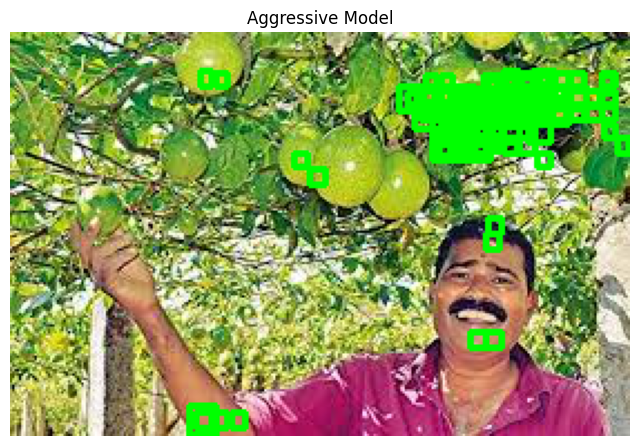

Low-Resolution Model Results:


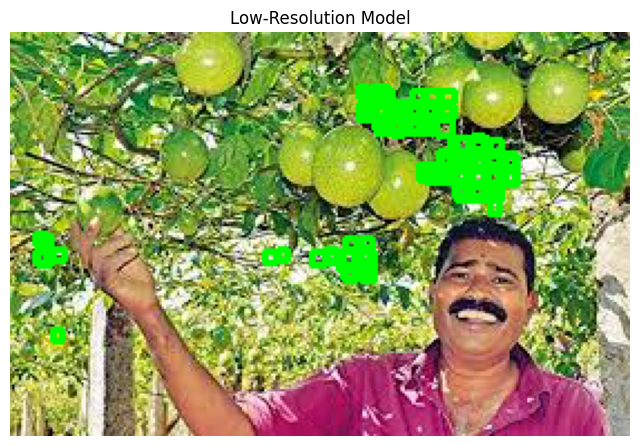


Processing: download (6).jpeg
Baseline Model Results:


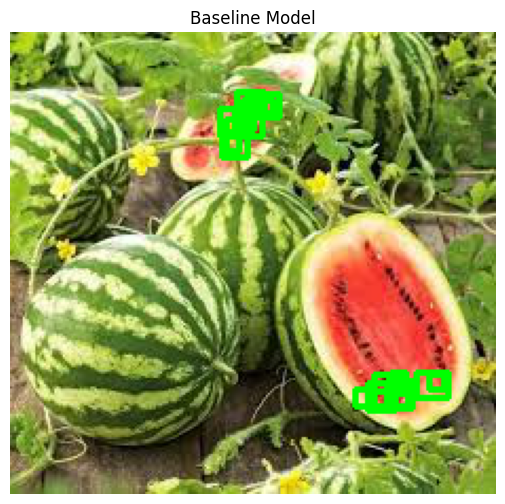

Aggressive Augmentation Model Results:


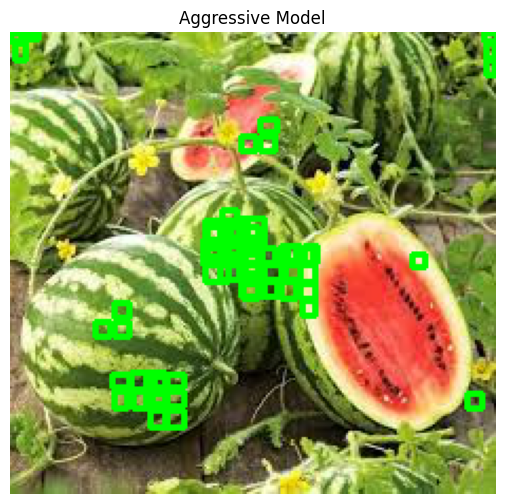

Low-Resolution Model Results:


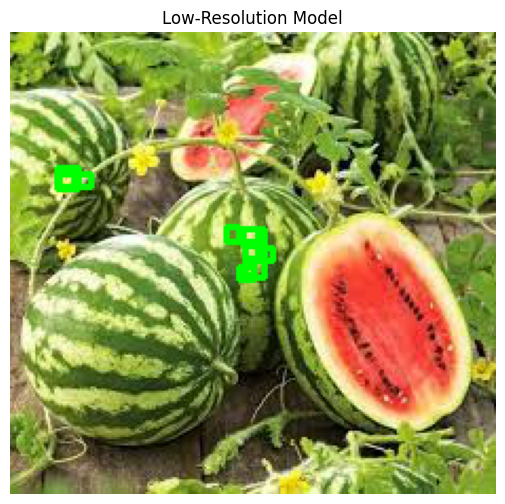


Processing: download.jpeg
Baseline Model Results:


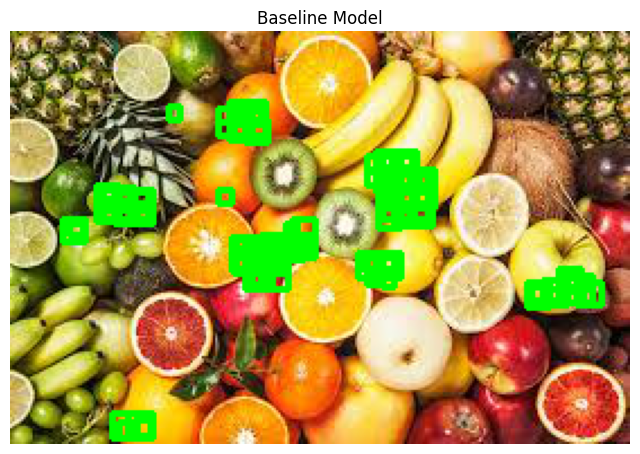

Aggressive Augmentation Model Results:


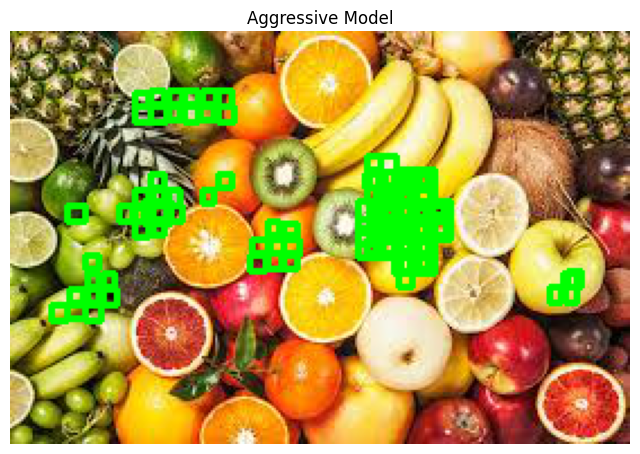

Low-Resolution Model Results:


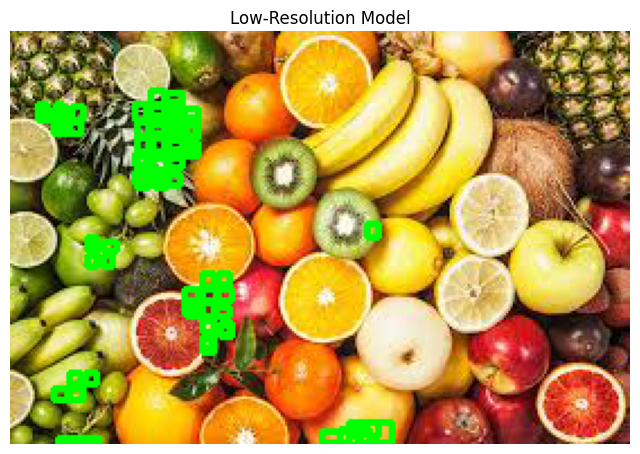


Processing: images.jpeg
Baseline Model Results:


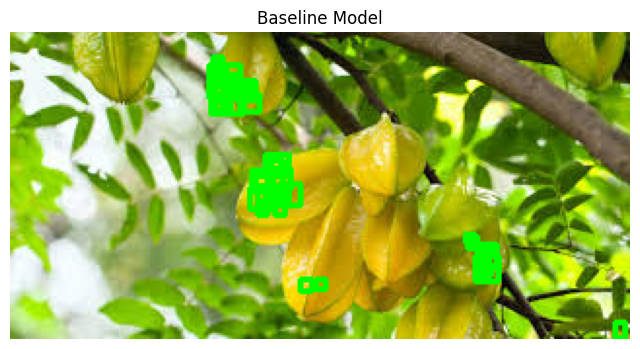

Aggressive Augmentation Model Results:


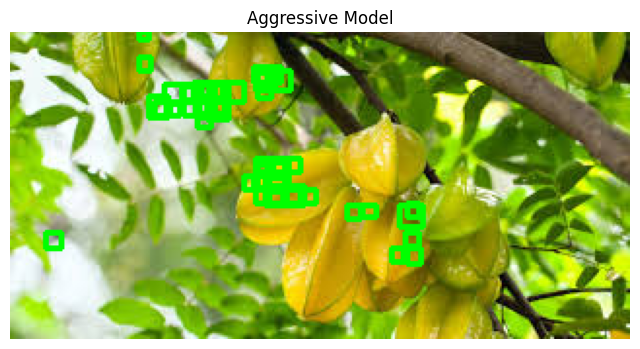

Low-Resolution Model Results:


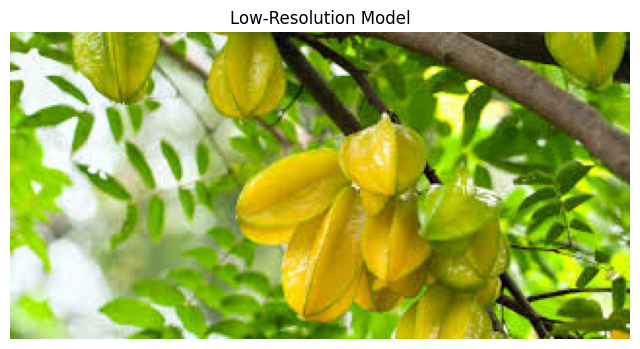

In [41]:
def load_trained_model(model_path):
    model = get_fasterrcnn_resnet34_model(num_classes=2)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    return model
model_baseline = load_trained_model("model_baseline.pth")
model_aggressive = load_trained_model("model_aggressive.pth")
model_lowres = load_trained_model("model_lowres.pth")
external_image_paths = sorted(glob("external/*.jpeg"))

def detect_objects(model, image_path, threshold=0.1):
    image = Image.open(image_path).convert("RGB")
    image_tensor = F.to_tensor(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = model(image_tensor)[0]
    boxes = output["boxes"].cpu().numpy()
    scores = output["scores"].cpu().numpy()
    filtered_boxes = [box for box, score in zip(boxes, scores) if score > threshold]
    return np.array(filtered_boxes), image

def visualize_predictions(image, boxes, title="Detection Result"):
    img_np = np.array(image)
    img_np = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)
    for box in boxes:
        x1, y1, x2, y2 = map(int, box)
        cv2.rectangle(img_np, (x1, y1), (x2, y2), (0, 255, 0), 2)
    plt.figure(figsize=(8, 6))
    plt.imshow(cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")
    plt.show()

for image_path in external_image_paths:
    print(f"\nProcessing: {os.path.basename(image_path)}")
    boxes_baseline, image = detect_objects(model_baseline, image_path)
    boxes_aggressive, _ = detect_objects(model_aggressive, image_path)
    boxes_lowres, _ = detect_objects(model_lowres, image_path)
    print("Baseline Model Results:")
    visualize_predictions(image, boxes_baseline, title="Baseline Model")
    print("Aggressive Augmentation Model Results:")
    visualize_predictions(image, boxes_aggressive, title="Aggressive Model")
    print("Low-Resolution Model Results:")
    visualize_predictions(image, boxes_lowres, title="Low-Resolution Model")

## 1. Performance on Different Fruit Varieties

### Observations from Images

The images depict different fruit varieties such as apples, oranges, bananas, watermelons, and passion fruit. The **Baseline Model** performs relatively well for structured orchards, where fruits are clearly visible. However, detection deteriorates in cases where:
- Fruits are **densely clustered** (as seen in apple orchards).
- Fruits **blend with the background** due to color similarities.
- The model misidentifies **small or partially occluded fruits**.

The **Aggressive Augmentation Model** showed:
- Over-detection in some images, leading to **false positives** (e.g., misidentifying non-fruit objects).
- Improved detection in **varied lighting** conditions.
- Difficulty in maintaining precision in **structured plantations**.

The **Low-Resolution Model** struggled in cases where:
- Fruits were **small and densely packed**.
- Images contained **highly textured backgrounds**, leading to false positives.
- The model **ignored some distant objects** due to reduced feature resolution.

## 2. Impact of Background Variations

- Images with **cluttered or natural backgrounds** (leaves, branches) posed difficulties for all models.
- The **Baseline Model** performed the best in structured plantation settings but struggled in highly variable environments.
- The **Aggressive Augmentation Model** detected more objects but at the cost of increased false positives.
- The **Low-Resolution Model** suffered the most due to the loss of fine-grained features, causing it to miss smaller fruits.

## 3. Detection Accuracy Under Different Lighting Conditions

- **Bright Lighting:**
  - Baseline Model: Moderate detection, some false negatives.
  - Aggressive Model: Over-detection, increased false positives.
  - Low-Resolution Model: Struggled to detect fruits due to washed-out contrast.

- **Dim Lighting:**
  - Baseline Model: Lower confidence in detecting fruits.
  - Aggressive Model: Slightly better recall but at the expense of precision.
  - Low-Resolution Model: Performed the worst in detecting subtle fruit features.

## 4. Modifications Needed for Improved Performance

### a) Adapting the Model to Detect Multiple Fruit Types
- **Solution:** Train using a **multi-class Faster R-CNN** to distinguish between different fruit species.
- **Alternative:** Implement **instance segmentation (Mask R-CNN)** to refine fruit boundaries.

### b) Improving Robustness to Environmental Variations
- **Use of Augmentation Strategies:**
  - Randomized **brightness adjustments** to simulate natural variations.
  - Synthetic **background blurring** to make fruits stand out better.
  - **Occlusion simulation** to teach the model how to handle overlapping fruits.

### c) Handling Different Growth Stages and Ripeness Levels
- **Introduce ripeness classification:** Labeling fruits based on ripeness (green, semi-ripe, fully ripe) can help train the model for better differentiation.
- **Contrast-based segmentation:** Improved color segmentation techniques will help differentiate between green unripe fruits and surrounding foliage.
- **Multi-stage detection:** Introduce a **hierarchical classifier** that first detects fruits and then determines their ripeness using a secondary CNN model.

## 5. Conclusion
- The **Baseline Model** is best suited for structured environments but lacks adaptability.
- The **Aggressive Augmentation Model** increases recall but introduces **false positives**.
- The **Low-Resolution Model** is **computationally efficient** but struggles with finer details.
- Implementing **instance segmentation, multi-class training, and better augmentation** will improve adaptability across fruit types and environmental conditions.